In [1]:
import matplotlib.pyplot as plt 
import numpy as np 

In [2]:
fig = plt.figure(
    "Population density", 
    figsize = (4.5,2.), 
    facecolor = 'red', # background color
    )

<Figure size 324x144 with 0 Axes>

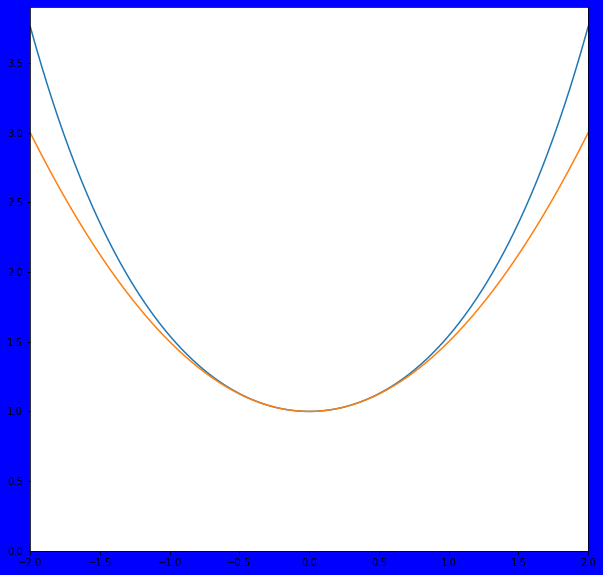

In [7]:
# to plot data we need Axes Object

# alternative: fig, ax = plt.subplots()
fig = plt.figure(figsize=(10,10), facecolor='blue')
ax = fig.add_subplot()

x = np.linspace(-2,2,10000)
line_cosh, = ax.plot(x, np.cosh(x))
line_quad, = ax.plot(x, 1+ x**2 /2 )

ax.set_xlim(-2,2)
ax.set_ylim(bottom = 0)

plt.show()

## Scatter Plot

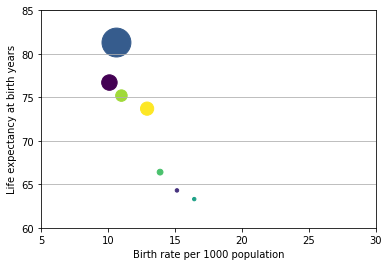

In [20]:
import  numpy as np 
import matplotlib.pyplot as plt 
countries = ['a','b','c','d','e','f','g','h']

birth_rate = np.random.random_sample(8)*10 + np.random.randint(0,10,size = 8)
life_expectancy = [76.7,64.3,81.3,78.8,63.3,66.4,75.2,73.7]
GDP = np.array([4800,240,16700,37700,230,670,2640,3490])

fig, ax = plt.subplots()

colors = range(len(countries))

ax.scatter(birth_rate, life_expectancy, c= colors, s = GDP/20)
ax.set_xlim(5,30)
ax.set_ylim(60,85)
ax.set_xlabel("Birth rate per 1000 population")
ax.set_ylabel("Life expectancy at birth years")

# grid lines
ax.yaxis.grid(True)

plt.show()

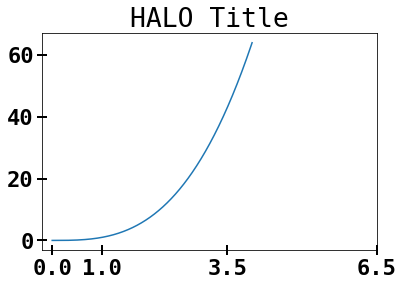

In [43]:
## Log Scales

fig, ax = plt.subplots()

a = np.linspace(0,4, 1000)
ax.plot(a, a*a*a)

# ax.set_xscale('log')
# ax.set_yscale('log')

ax.set_title("HALO Title")

# ax.minorticks_on()

ax.set_xticks([0,1,3.5,6.5])

# customize tick marks
ax.tick_params(which='major', length = 10,width = 2, direction = 'inout')

plt.show()

In [51]:
# change default font properties 
from matplotlib import rc 
font_properties = { 'family' : 'monospace',
                    'weight' : 'bold',
                    'size'   : 10
}
rc('font', **font_properties)

## Error Bars

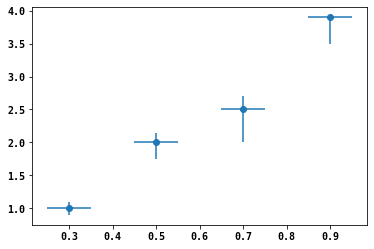

In [52]:

fig, ax = plt.subplots()
x = np.array([0.3,0.5,0.7,0.9])
y = np.array([1,2,2.5,3.9])

xerr = 0.05
# Asymmetric, variable errors on y-data
yerr = np.array([[0.1,0.25,0.5,0.4],[0.1,0.15,0.2,0]])

ax.errorbar(x,y, yerr, xerr, fmt = 'o', ls = '')

plt.show()

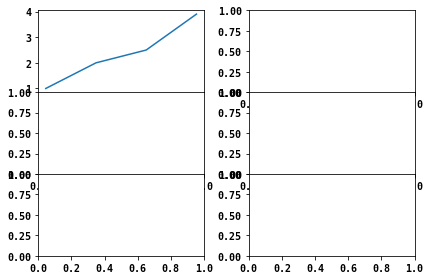

In [57]:
## subplots 
fig, axes = plt.subplots(nrows = 3, ncols = 2)
axes.shape
ax1 = axes[0,0]
ax1.plot(x,y)

fig.tight_layout() # dun want the plot to bash each other 
fig.subplots_adjust(hspace = 0)

plt.show()

## Other charts 
- ax.bar
- ax.pie
- ax.polar 


## Annotate 

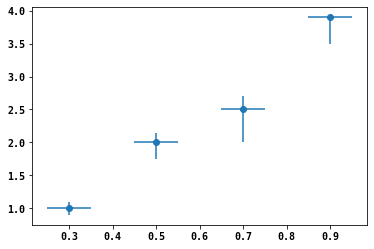

In [64]:

fig, ax = plt.subplots()
x = np.array([0.3,0.5,0.7,0.9])
y = np.array([1,2,2.5,3.9])

xerr = 0.05
# Asymmetric, variable errors on y-data
yerr = np.array([[0.1,0.25,0.5,0.4],[0.1,0.15,0.2,0]])

ax.errorbar(x,y, yerr, xerr, fmt = 'o', ls = '')
ax.annotate("default line", xy = (2,2), xytext = (2,2), arrowprops = {'arrowstyle': '-'}, va = 'center')

plt.show()

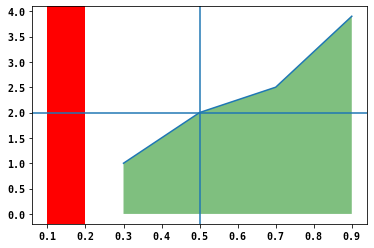

In [79]:
# draw line
fig, ax = plt.subplots()

ax.plot(x,y)

ax.axhline(2, 0, 1)
ax.axvline(0.5,0,4)
# rectangle color
ax.axvspan(0.1,0.2, color = 'red', ec = 'none', alpha = 1)

ax.fill_between(x,0,y,facecolor = 'g', alpha = 0.5)


plt.show()

## Heatmaps

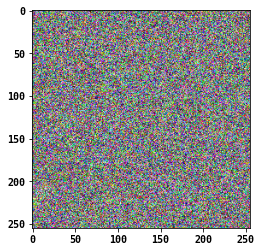

In [81]:
import matplotlib.pyplot as plt 
import matplotlib.image as mpimg 
# im = mpimg.imred('image.jpg')

im = np.random.randint(0,255,(255,255,3))
plt.imshow(im)
plt.show()

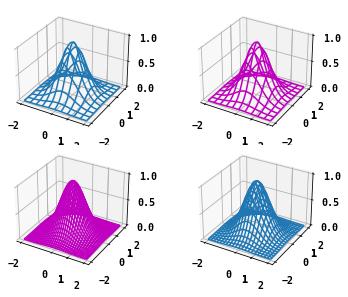

In [100]:
# 3 dimensional surface plots
import numpy as np 
import matplotlib.pyplot as plt 
from mpl_toolkits.mplot3d import Axes3D 
import matplotlib.cm as cm 

L, n = 2, 400 
x = np.linspace(-L,L,n)
y = x.copy()
X,Y = np.meshgrid(x,y)
Z = np.exp(-(X**2 + Y**2))

fig, ax = plt.subplots(nrows = 2, ncols = 2, subplot_kw = {'projection': '3d'})

ax[0,0].plot_wireframe(X,Y,Z, rstride = 40, cstride = 40)
ax[0,1].plot_wireframe(X,Y,Z, rstride = 40, cstride = 40, color = 'm')
ax[1,0].plot_wireframe(X,Y,Z, rstride = 12, cstride = 12, color = 'm')
ax[1,1].plot_wireframe(X,Y,Z, rstride = 20, cstride = 20, cmap = cm.hot)

for axes in ax.flatten():
    axes.set_xticks([-2,1,0,1,2])
    axes.set_yticks([-2,1,0,1,2])
    axes.set_zticks([0,0.5,1])
fig.tight_layout()
plt.show()

## Animation

In [83]:
## Animated Line
import numpy as np 
import matplotlib.pyplot as plt 
from matplotlib.animation import PillowWriter 
from matplotlib import rc, animation
from IPython.display import HTML
import IPython
%matplotlib notebook

# Time step for the animations(s), max time to animate for (s)
dt, tmax = 0.01, 5
# Signal frequency (s-1), decay constant (s-1)
f, alpha = 2.5, 1 
# List to hold the data
t, M = [], []

fig, ax = plt.subplots()
line, = ax.plot([],[])
ax.set_xlim(0, tmax)
ax.set_ylim(-1, 1)
ax.set_xlabel('t/s')
ax.set_ylabel('M (arb. units)')

def init():
    line.set_data([], [])
    return (line,)

def animate(i):
    '''Draw the frame i of the animation'''
    _t = i*dt 
    t.append(_t)
    M.append(np.sin(2*np.pi*f*_t)*np.exp(-alpha*_t))

    line.set_data(t, M) # Line 2D
    return line,

interval, nframes = 1000* dt, int(tmax/dt)
# Animate once (set repeat = False, so the animation doesn't loop)
ani = animation.FuncAnimation(fig, animate, frames=nframes, init_func=init, repeat= False, interval=interval, blit=True)
# ani.save('test.gif', writer = 'pillow' )
rc('animation', html='jshtml')
HTML(ani.to_jshtml())
# plt.show()

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [84]:
# another coil
%matplotlib notebook
plt.style.use('dark_background')

fig = plt.figure()
ax = plt.axes(xlim = (-50,50), ylim = (-50,50))
line, = ax.plot([],[], lw = 2)

xdata = []
ydata = []
def init():
    line.set_data([],[])
    return line,

def animate(i):
    # t is the parameter
    t = 0.1 * i

    x = t* np.sin(t)
    y = t* np.cos(t)
    xdata.append(x)
    ydata.append(y)
    line.set_data(xdata,ydata)
    return line, 

plt.title("Creating a growing coil with matplotlib")

plt.axis('off')

anim = animation.FuncAnimation(fig, animate, init_func=init, frames = 500, interval = 20, blit = True)

# anim.save('coil.gif', writer = 'pillow' )
# !pip install networkx
rc('animation', html='jshtml')
HTML(anim.to_jshtml())

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>